In [2]:
import os
import argparse
import shutil
import pickle
import torch
import sys
import numpy as np
sys.path.append(os.path.abspath(os.path.join(os.getcwd(), './..')))
from src.utils.data import remap, fetch_data_to_write
from tqdm import tqdm
from src.utils.utils import optimal_distance
import cv2
from ultralytics import YOLO
import matplotlib.pyplot as plt

In [120]:
target_labels = {'car', 'bus', 'truck'}

def run_images(img_events, img_rgb, model_events, model_rgb, idx, prev_image):
    results_events = model_events.track(img_events, persist=True, verbose=False)
    results_rgb = model_rgb.track(img_rgb, persist=True, verbose=False)
    if prev_image is None:
        return

    num_of_pred_obj = 0
    for box in results_events[0].boxes:
        confidence = float(box.conf[0])
        class_id = int(box.cls[0])
        # label = model.names[class_id]

        if confidence > conf_thr:
            num_of_pred_obj += 1
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            cv2.rectangle(prev_image, (x1, y1), (x2, y2), (0, 255, 0), 3)
            # cv2.putText(img_events, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
    # if idx in range(765, 786, 2): 
    #     plt.figure()
    #     plt.axis('off')
    #     plt.imshow(img_events)
    event_images.append(prev_image)
        
    pred_obj_in_events.append(num_of_pred_obj)

    num_of_pred_obj_rgb = 0
    for box in results_rgb[0].boxes:
        confidence = float(box.conf[0])
        class_id = int(box.cls[0])
        label = model_rgb.names[class_id]

        if confidence > conf_thr and label in target_labels:
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            if np.abs(x1-x2)/1440 < 0.02 or np.abs(y1-y2)/1080 < 0.02:
                continue
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            cv2.rectangle(img_rgb, (x1, y1), (x2, y2), (0, 255, 0), 6)

            num_of_pred_obj_rgb += 1
    pred_obj_in_rgb.append(num_of_pred_obj_rgb)
    # if idx in range(765, 786, 2): 
    #     plt.figure()
    #     plt.axis('off')
    #     plt.imshow(img_rgb)
    rgb_images.append(img_rgb)
    


In [255]:
recording_names = os.listdir('/mnt/raid0a/Dimitris/DSEC/event_recordings/')
images_prefix = f'../../../E2F/final_res/'
rgb_prefix = '/mnt/raid0a/Dimitris/DSEC/images_recordings/'

model_name = 'e2f_35/x_True_True/weights/epoch20.pt'
conf_thr = 0.35
dataset_type = 'val'
pred_obj = []
gt_obj = []
rgb_images = []
event_images = []
flagged_sequences = []
prev_image = None
for rec_name in recording_names:
    # if 'interlaken_00_b' not in rec_name:
    if 'zurich_city_04_f' not in rec_name:
        continue
    images = os.listdir(images_prefix+rec_name)
    images.sort()
    optimal_distance_val = optimal_distance('DSEC')[0]
    metric = fetch_data_to_write(['partial_contrast'], 'info_DSEC', '',  rec_name)
    metric = metric['partial_contrast']
    distance = np.sum(np.square((metric-optimal_distance_val)), axis=1)
    is_in_test = []
    model_rgb = YOLO('yolo11x')
    model_events = YOLO(model_name)
    pred_obj_in_events = []
    pred_obj_in_rgb = []
    flags = []
    prev = 0
    
    for idx, image in enumerate(images):
        if idx not in range(690, 780, 1):
            continue
        if '.png' not in image:
            continue
        if idx < 5:
            continue

        low = max(0, idx-70)
        high = min(idx+110, len(images))
        is_flagged = distance[idx] > 0.035
        if dataset_type == 'val':
            if (np.max(distance[low:high] > 0.035) and not ('zurich_city_01' in rec_name or 'zurich_city_02' in rec_name or 'zurich_city_06' in rec_name)):
                im1 = cv2.imread(images_prefix+rec_name+'/'+image)
                img = im1
                img_rgb = cv2.imread(rgb_prefix+f'{rec_name}/images/left/rectified/0{image[6:]}')

                    
                if idx == prev+1:
                    flags.append(is_flagged)
                    
                    prev += 1
                elif prev != 0:
                    print(idx)
                    prev = idx
                    flagged_sequences.append(flags)
                    pred_obj.append(pred_obj_in_events)
                    pred_obj_in_events = []
                    gt_obj.append(pred_obj_in_rgb)
                    pred_obj_in_rgb = []
                    flags = [is_flagged]
                else:
                    print(idx)
                    flags.append(is_flagged)
                    prev = idx
                # sdv
                run_images(img, img_rgb, model_events, model_rgb, idx, prev_image)
                prev_image = img
    
    if flags != []:
        pred_obj.append(pred_obj_in_events)
        gt_obj.append(pred_obj_in_rgb)
        flagged_sequences.append(flags)
        # print(flagged_sequences, len(flagged_sequences))



690


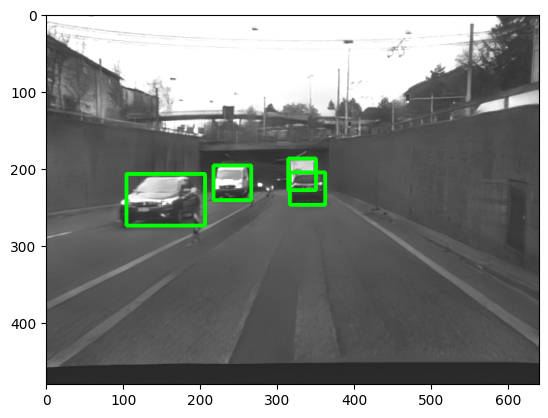

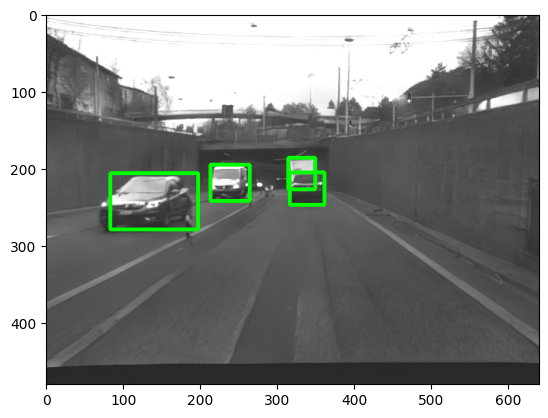

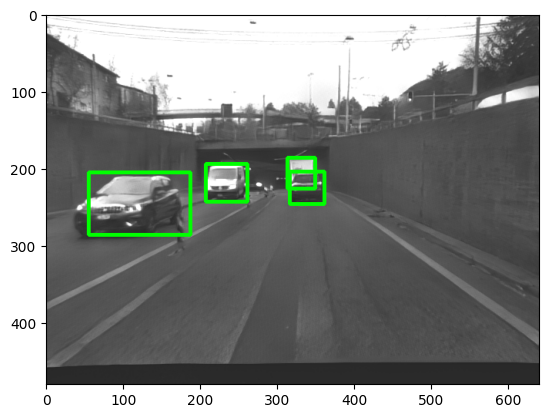

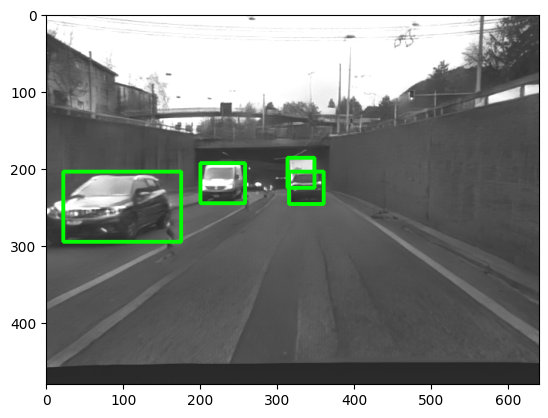

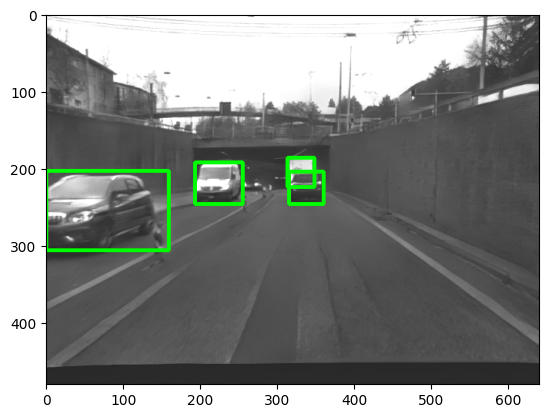

...

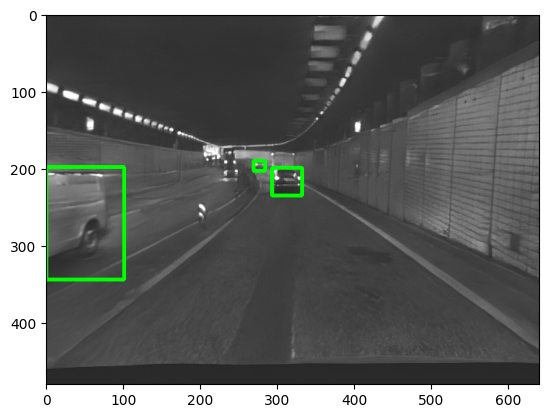

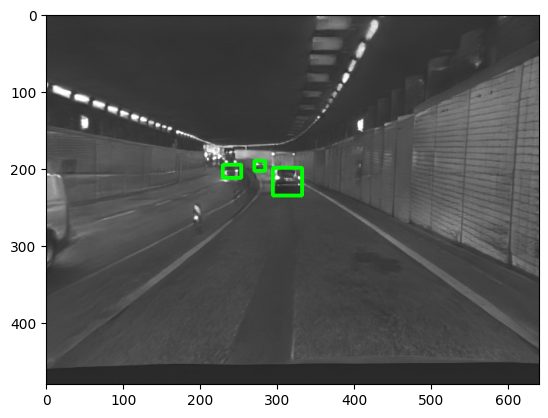

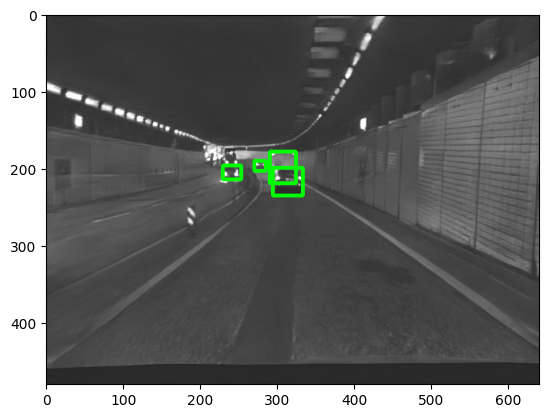

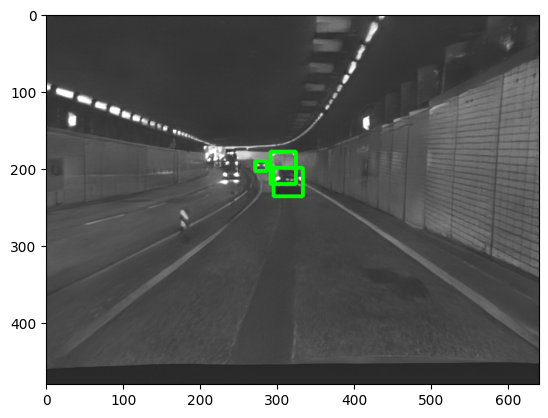

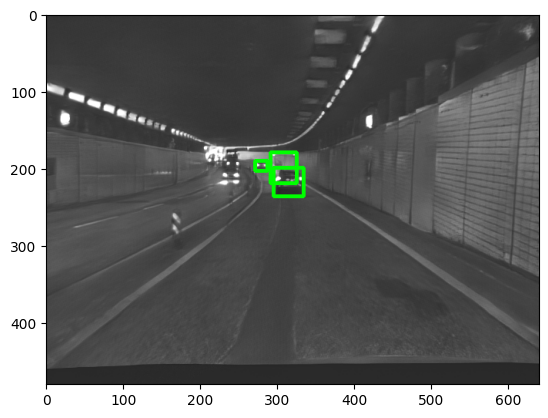

In [256]:
for i in event_images:
    plt.figure()
    plt.imshow(i)
    plt.show()
    plt.close()

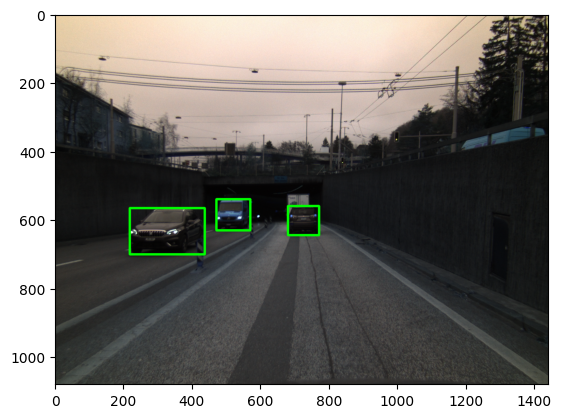

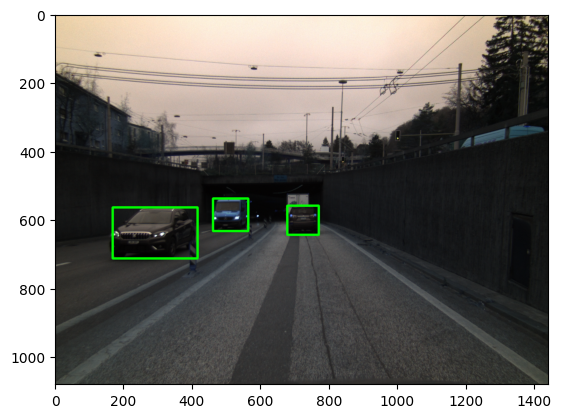

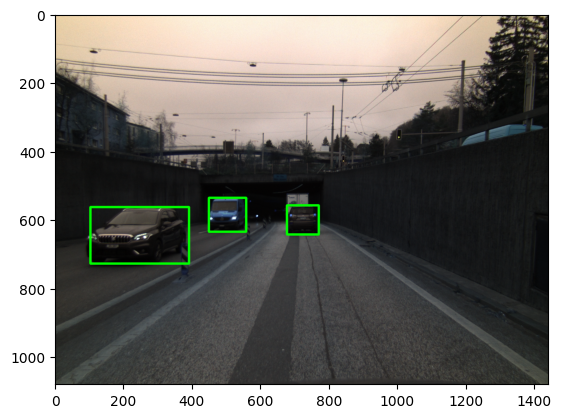

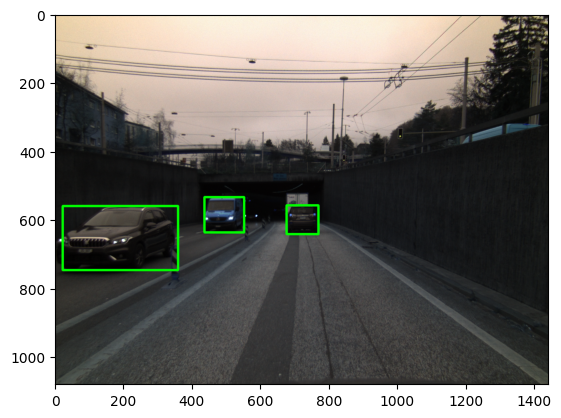

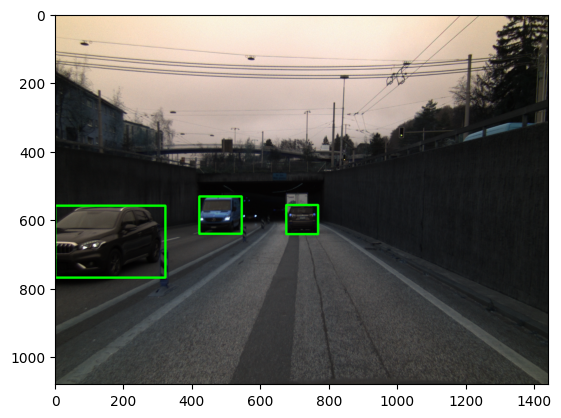

...

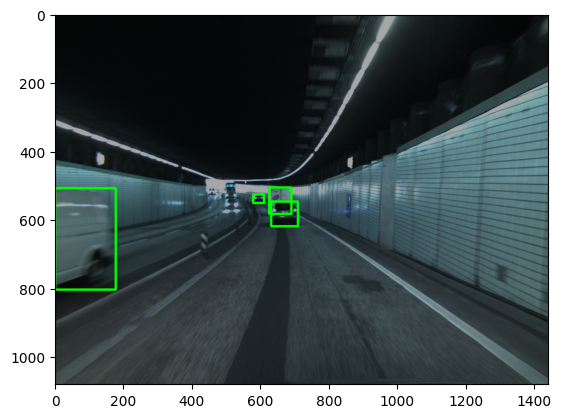

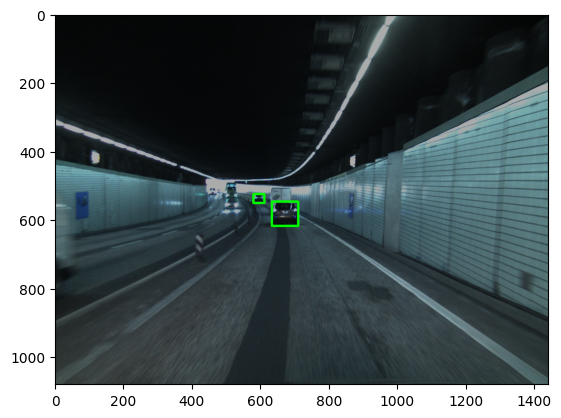

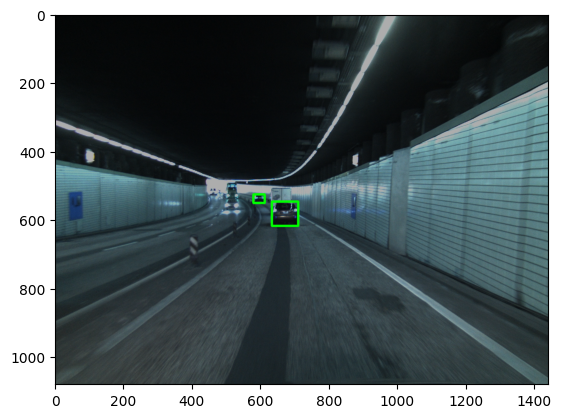

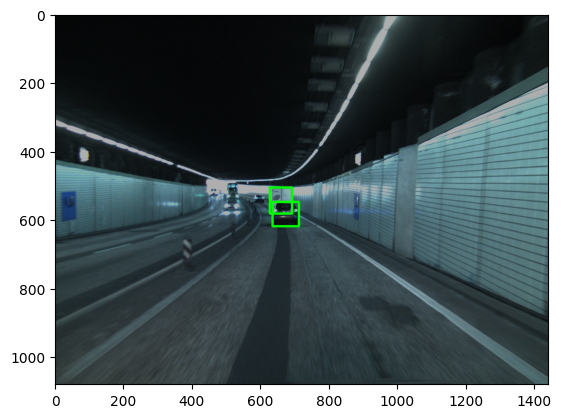

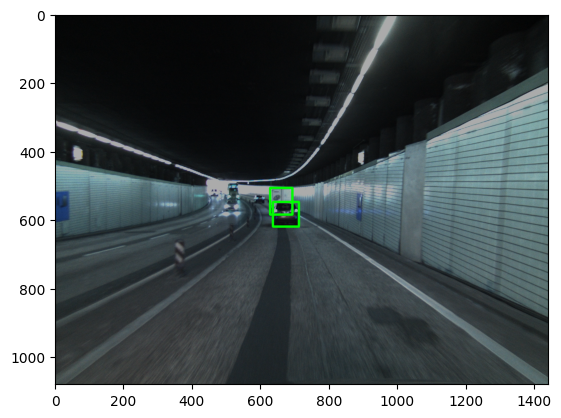

In [248]:
for i in rgb_images:
    plt.figure()
    plt.imshow(i)
    plt.show()
    plt.close()

In [257]:
video_name = 'video_rgb_3_new_data.avi'
height, width, layers = rgb_images[0].shape

video = cv2.VideoWriter(video_name, 0, 10, (width,height))

for image in rgb_images:
    video.write(image)

cv2.destroyAllWindows()
video.release()


In [258]:
video_name = 'video_events_3_new_data.avi'
height, width, layers = event_images[0].shape

video = cv2.VideoWriter(video_name, 0, 10, (width,height))

for image in event_images:
    video.write(image)

cv2.destroyAllWindows()
video.release()


#### [750, 805][840, 900] zurich [690, 855]